In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

import anndata as ad
import scanpy as sc

from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from umap import UMAP

from scroutines.miscu import is_in_polygon
from scroutines import powerplots

import importlib
importlib.reload(powerplots)
import utils_merfish # current dir
importlib.reload(utils_merfish)

<module 'utils_merfish' from '/u/project/zipursky/f7xiesnm/v1-bb/v1/myvisctx/analysis_merfish/utils_merfish.py'>

In [2]:
outdir = "/u/home/f/f7xiesnm/project-zipursky/v1-bb/v1/results_merfish/plots_230717"
outdatadir = "/u/home/f/f7xiesnm/project-zipursky/v1-bb/v1/results_merfish"
# !mkdir -p $outdir
!ls /data/qlyu/v1/results_merfish

ls: cannot access /data/qlyu/v1/results_merfish: No such file or directory


In [3]:
adata_a0 = ad.read('/u/home/f/f7xiesnm/project-zipursky/v1-bb/v1/results_merfish/ant_reg0_ctxglut_230623.h5ad')
adata_a1 = ad.read('/u/home/f/f7xiesnm/project-zipursky/v1-bb/v1/results_merfish/ant_reg1_ctxglut_230717.h5ad')
adata_p0 = ad.read('/u/home/f/f7xiesnm/project-zipursky/v1-bb/v1/results_merfish/pos_reg0_ctxglut_230719.h5ad')
adata_p1 = ad.read('/u/home/f/f7xiesnm/project-zipursky/v1-bb/v1/results_merfish/pos_reg1_ctxglut_230719.h5ad')

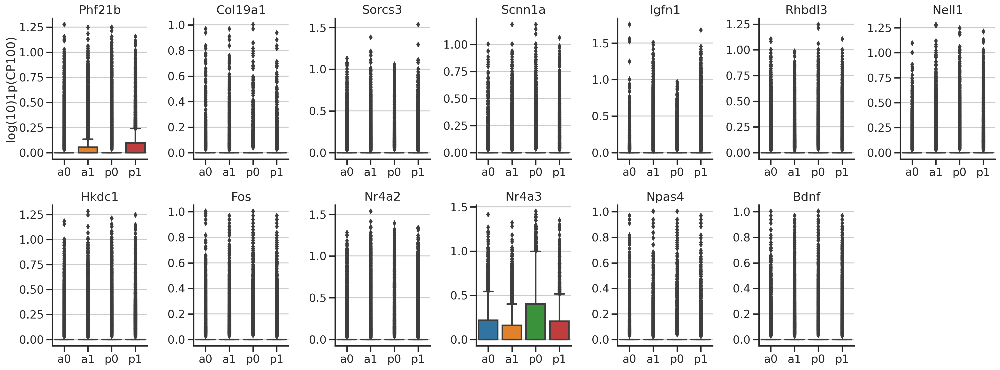

In [4]:
geneset1 = [
    'Phf21b',
    'Col19a1',
    'Sorcs3',
    'Scnn1a', 'Igfn1',
    'Rhbdl3', 'Nell1', 'Hkdc1',
    'Fos', 'Nr4a2', 'Nr4a3', 'Npas4', 'Bdnf',
]
n = len(geneset1)
nx = 7
ny = int((n+nx-1)/nx)

fig, axs = plt.subplots(ny,nx, figsize=(nx*3,ny*4))
axs.flat[0].set_ylabel('log(10)1p(CP100)')

for i, (gn, ax) in enumerate(zip(geneset1, axs.flat)):
    g_a0 = np.log10(np.ravel(1+adata_a0[:,gn].layers['norm']))
    g_a1 = np.log10(np.ravel(1+adata_a1[:,gn].layers['norm']))
    g_p0 = np.log10(np.ravel(1+adata_p0[:,gn].layers['norm']))
    g_p1 = np.log10(np.ravel(1+adata_p1[:,gn].layers['norm']))
    
    sns.boxplot(pd.DataFrame([g_a0, g_a1, g_p0, g_p1], 
                       index=['a0', 'a1', 'p0', 'p1']).T, 
                ax=ax)
    sns.despine(ax=ax)
    ax.set_title(gn)
    
for ax in axs.flat[i+1:]:
    ax.axis('off')
    
fig.tight_layout()
plt.show()

In [5]:
def plot_fish(gn, vmax_p=98):
    """all 4 slices consistently
    """
    x_a0, y_a0, g_a0 = utils_merfish.get_xyg(adata_a0, gn, 'norm')
    x_a1, y_a1, g_a1 = utils_merfish.get_xyg(adata_a1, gn, 'norm')
    x_p0, y_p0, g_p0 = utils_merfish.get_xyg(adata_p0, gn, 'norm')
    x_p1, y_p1, g_p1 = utils_merfish.get_xyg(adata_p1, gn, 'norm')

    g = np.hstack([g_a0, g_a1, g_p0, g_p1])
    vmax = np.percentile(g, vmax_p)
    flag = ''
    if vmax < 1e-7: 
        vmax = 1 # non-expressed
        flag = '**not expressed**'
    title = f"{gn} (max {vmax:.2g} at {vmax_p:.2g} pctl) {flag}"

    fig, axs = plt.subplots(2,2,figsize=(2*6,2*4))
    fig.suptitle(title, fontsize=15)
    ax = axs[0,0]
    utils_merfish.st_scatter_ax(fig, ax, x_a0, y_a0, gexp=g_a0, s=2, unit_norm=True, title='P14 ant', vmax=vmax)
    ax = axs[0,1]
    utils_merfish.st_scatter_ax(fig, ax, x_a1, y_a1, gexp=g_a1, s=2, unit_norm=True, title='P28 ant', vmax=vmax)
    ax = axs[1,0]
    utils_merfish.st_scatter_ax(fig, ax, x_p0, y_p0, gexp=g_p0, s=2, unit_norm=True, title='P14 pos', vmax=vmax)
    ax = axs[1,1]
    utils_merfish.st_scatter_ax(fig, ax, x_p1, y_p1, gexp=g_p1, s=2, unit_norm=True, title='P28 pos', vmax=vmax)
    fig.tight_layout()
    plt.show()
    
def plot_fish_gmean(gns, vmax_p=98, vmin_p=2, title='', cmap='coolwarm'):
    """all 4 slices consistently
    """
    x_a0, y_a0, g_a0 = utils_merfish.get_xygmean(adata_a0, gns, 'norm')
    x_a1, y_a1, g_a1 = utils_merfish.get_xygmean(adata_a1, gns, 'norm')
    x_p0, y_p0, g_p0 = utils_merfish.get_xygmean(adata_p0, gns, 'norm')
    x_p1, y_p1, g_p1 = utils_merfish.get_xygmean(adata_p1, gns, 'norm')

    g = np.hstack([g_a0, g_a1, g_p0, g_p1])
    vmax = np.percentile(g, vmax_p)
    vmin = np.percentile(g, vmin_p)
    title = title + f" (n={len(gns)})"

    fig, axs = plt.subplots(2,2,figsize=(2*6,2*4))
    fig.suptitle(title, fontsize=15)
    ax = axs[0,0]
    utils_merfish.st_scatter_ax(fig, ax, x_a0, y_a0, gexp=g_a0, s=2, title='P14 ant', vmin=vmin, vmax=vmax, cmap=cmap)
    ax = axs[0,1]
    utils_merfish.st_scatter_ax(fig, ax, x_a1, y_a1, gexp=g_a1, s=2, title='P28 ant', vmin=vmin, vmax=vmax, cmap=cmap)
    ax = axs[1,0]
    utils_merfish.st_scatter_ax(fig, ax, x_p0, y_p0, gexp=g_p0, s=2, title='P14 pos', vmin=vmin, vmax=vmax, cmap=cmap)
    ax = axs[1,1]
    utils_merfish.st_scatter_ax(fig, ax, x_p1, y_p1, gexp=g_p1, s=2, title='P28 pos', vmin=vmin, vmax=vmax, cmap=cmap)
    fig.tight_layout()
    plt.show()
    
# functions (the teacher wrote for you to use later)
def rot2d(x, y, theta, unit='degree'):
    """ rotate data points defined by `x` and `y` by `theta` degree
    """
    a = np.vstack([x,y]).T
    if unit == 'degree':
        theta = theta*np.pi/180 # convert to radian

    R = np.array([[np.cos(theta), -np.sin(theta)], [np.sin(theta), np.cos(theta)]])
    ar = a.dot(R.T)
    return ar[:,0], ar[:,1]

def st_scatter(x, y, gexp=None, vmax_p=98, title='', s=1, cbar_label='', output='', cmap='rocket_r', axis_off=True):
    """customized scatter plot -- yesterday's progress
    """
  
    fig, ax = plt.subplots(figsize=(10,8))
    if gexp is not None:
        vmax = np.percentile(gexp, vmax_p)
        g = ax.scatter(x, y, c=gexp, s=s, edgecolor='none', vmax=vmax, cmap=cmap, rasterized=True)
        fig.colorbar(g, label=cbar_label, shrink=0.3)
    else:
        g = ax.scatter(x, y, s=s, edgecolor='none', cmap=cmap, rasterized=True)
  
    if axis_off:
        ax.axis('off')
    ax.set_title(title)
    ax.set_aspect('equal')
  
    if output:
        powerplots.savefig_autodate(fig, output)
        
    return 

# visualize clusters
def plot_cluster(clsts, x, y, ux, uy, s=1, axis_off=True):
    """this assumes `clsts` is a integer that starts from 0
    """
    from matplotlib import colors
  
    unq_clsts, inv = np.unique(clsts, return_inverse=True)
    n_unq = len(unq_clsts)
    # colors = np.array(sns.color_palette('husl', n_unq))
    # c_vec = colors[inv]
  
    cmap = plt.cm.jet
    norm = colors.BoundaryNorm(np.arange(-0.5, n_unq, 1), cmap.N)
  
    fig, axs = plt.subplots(1, 2, figsize=(8*2,6))
    
    ax = axs[0]
    g = ax.scatter(x, y, norm=norm, cmap=cmap, c=clsts, s=s, edgecolor='none')
    ax.set_title('XY (spatial distribution)')
    ax.set_aspect('equal')
    if axis_off:
        ax.axis('off')
    
    ax = axs[1]
    ax.scatter(ux, uy, norm=norm, cmap=cmap, c=clsts, s=s, edgecolor='none')
    ax.set_title('UMAP (molecular similarity)')
    ax.set_aspect('equal')
    if axis_off:
        ax.axis('off')
  
    fig.colorbar(g, ax=ax, label='clusters', ticks=np.arange(n_unq), shrink=0.7)
    return fig, axs

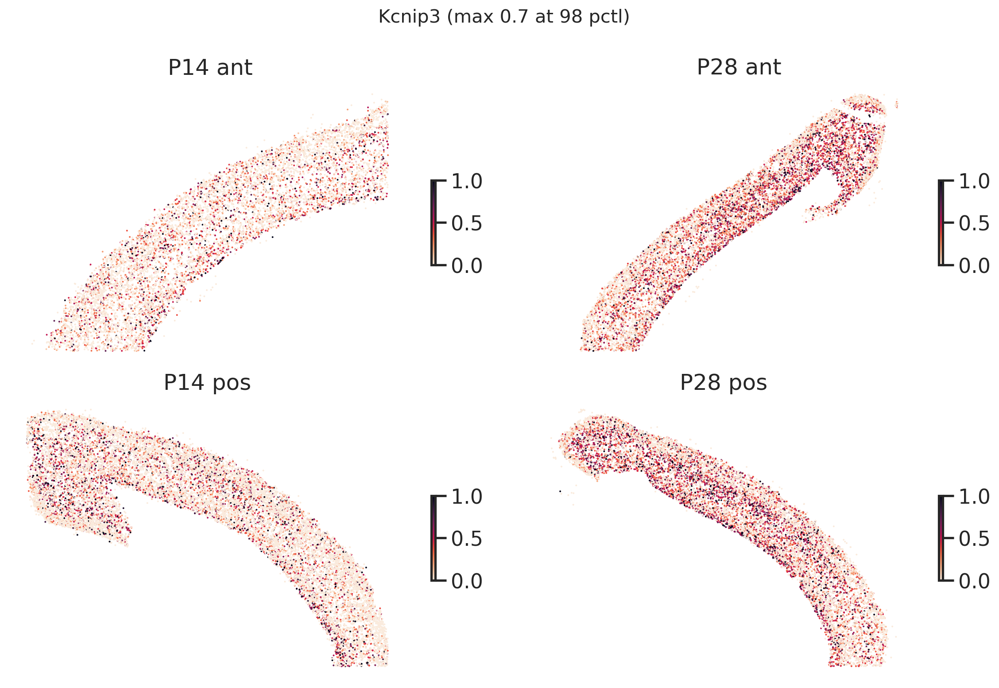

In [6]:
gn = 'Kcnip3'
plot_fish(gn, vmax_p=98)

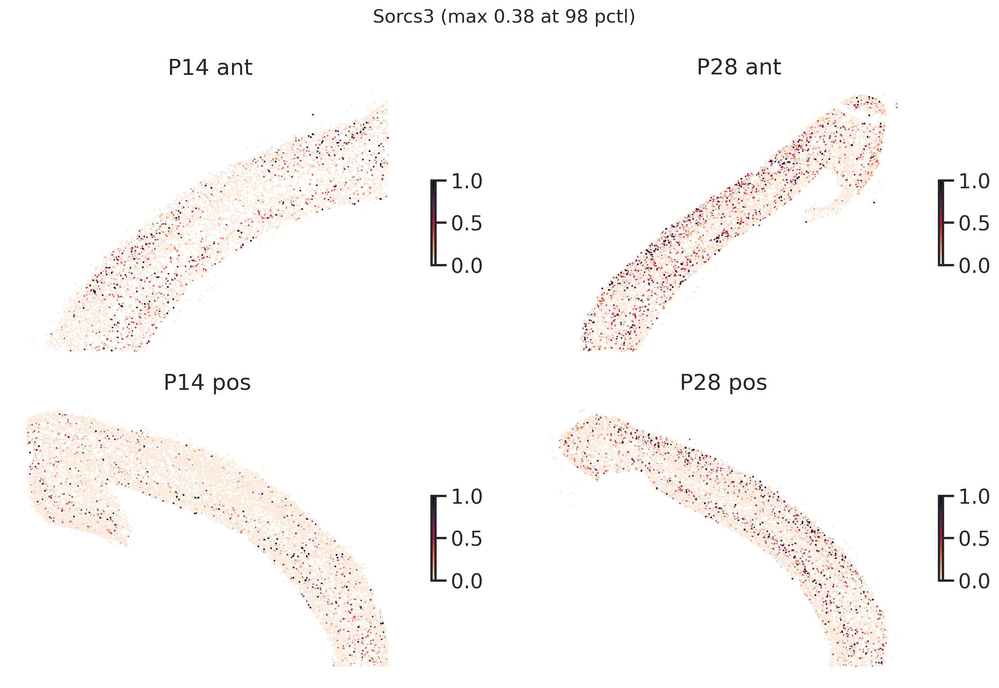

In [7]:
gn = 'Sorcs3'
plot_fish(gn, vmax_p=98)

# do some clustering

In [8]:
adata = adata_p1
adata

AnnData object with n_obs × n_vars = 19685 × 500
    obs: 'x', 'y', 'gncov', 'fpcov', 'EntityID', 'fov', 'volume', 'center_x', 'center_y', 'min_x', 'min_y', 'max_x', 'max_y', 'anisotropy', 'transcript_count', 'perimeter_area_ratio', 'solidity', 'DAPI_raw', 'DAPI_high_pass', 'PolyT_raw', 'PolyT_high_pass', 'leiden_r0.1', 'leiden_r0.2', 'leiden_spatial_r0.02', 'leiden_r0.5'
    uns: 'leiden', 'neighbors'
    obsm: 'blanks', 'pca', 'umap', 'xy'
    layers: 'norm'
    obsp: 'connectivities', 'distances'

In [9]:
lnorm = np.log10(1+adata.layers['norm']) # .sum(axis=1)
pcs = PCA(n_components=20).fit_transform(lnorm)

In [10]:
adata.layers['lnorm'] = lnorm

In [11]:
adata.obsm['X_pca'] = pcs
sc.pp.neighbors(adata, n_neighbors=60, n_pcs=20, use_rep='X_pca')

In [12]:
sc.tl.leiden(adata, resolution=0.2)

In [13]:
sc.tl.paga(adata)
sc.pl.paga(adata, plot=False)  # remove `plot=False` if you want to see the coarse-grained graph
sc.tl.umap(adata, init_pos='paga')

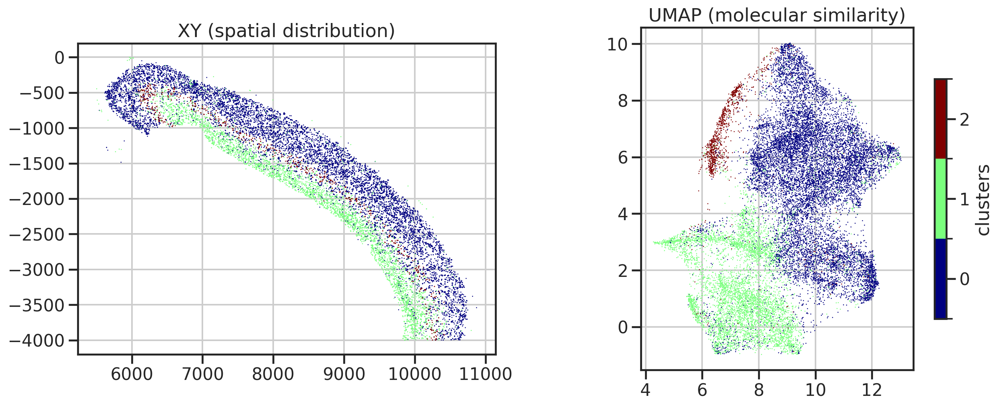

In [14]:
clsts = adata.obs['leiden'].astype(int)
x = adata.obs['x']
y = adata.obs['y']
ux = adata.obsm['umap'][:,0]
uy = adata.obsm['umap'][:,1]
plot_cluster(clsts, x, y, ux, uy, axis_off=False)
plt.show()

/u/home/f/f7xiesnm/.conda/envs/napari/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


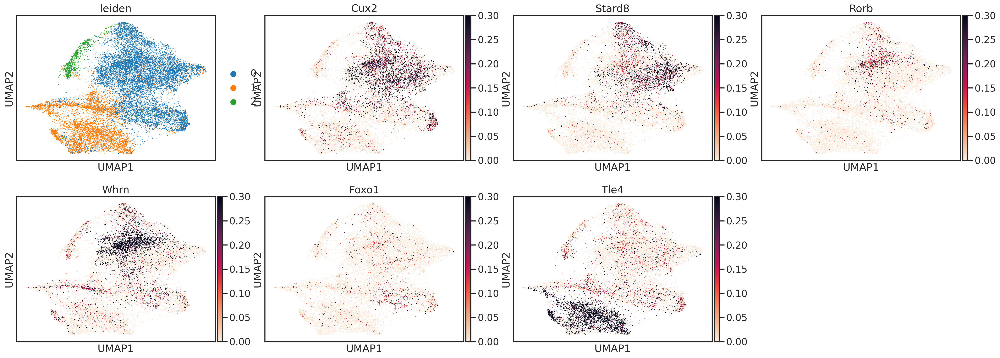

In [15]:
gns = ['Cux2', 'Stard8', 'Rorb', 'Whrn', 'Foxo1', 'Tle4']
sc.pl.umap(adata, layer='lnorm', color=['leiden']+gns, cmap='rocket_r', vmax=0.3)

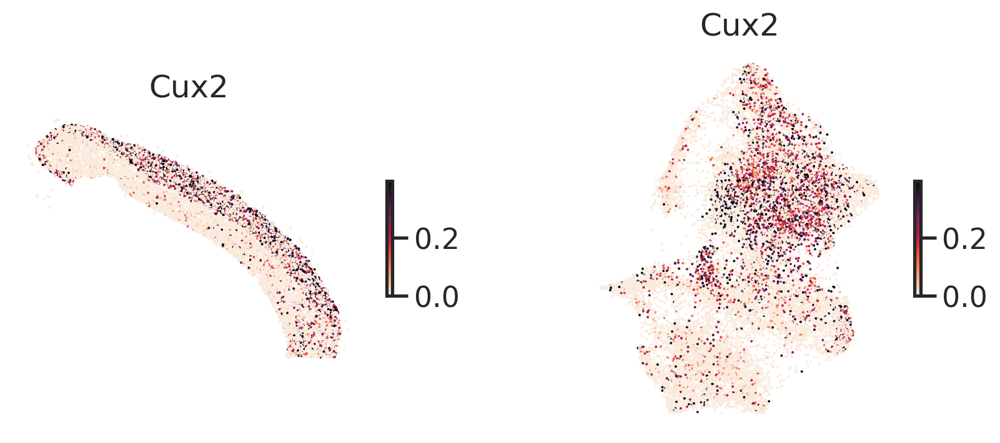

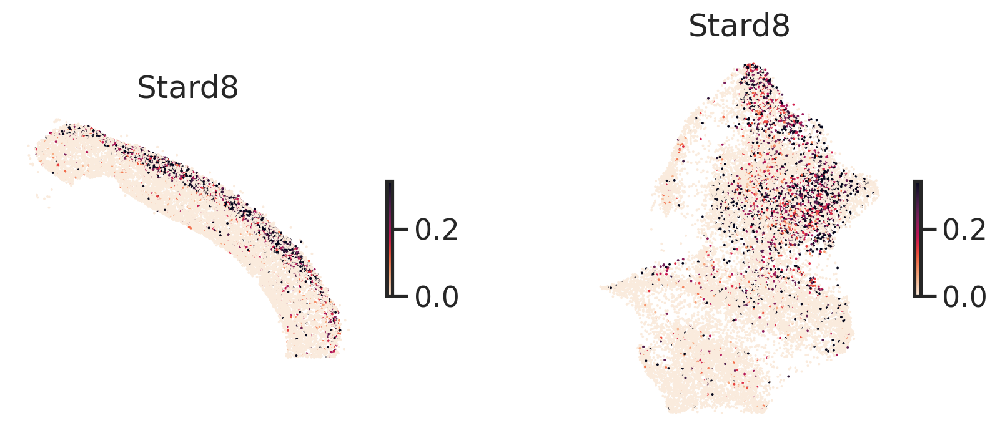

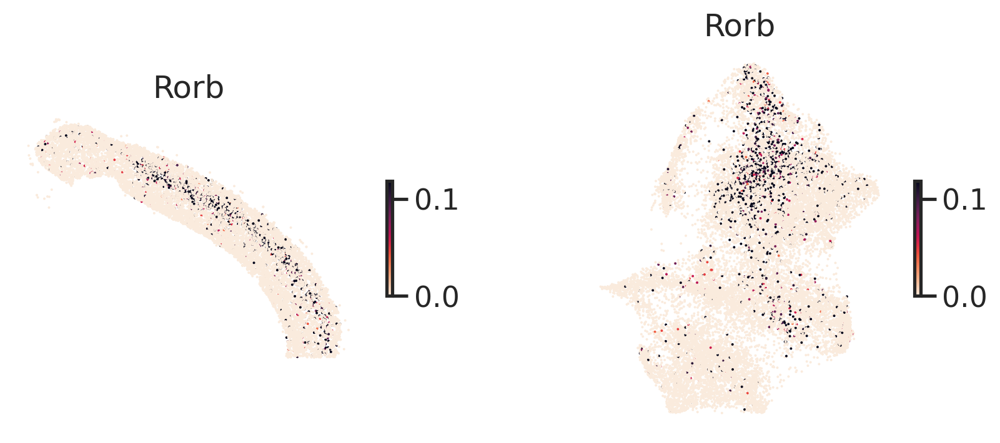

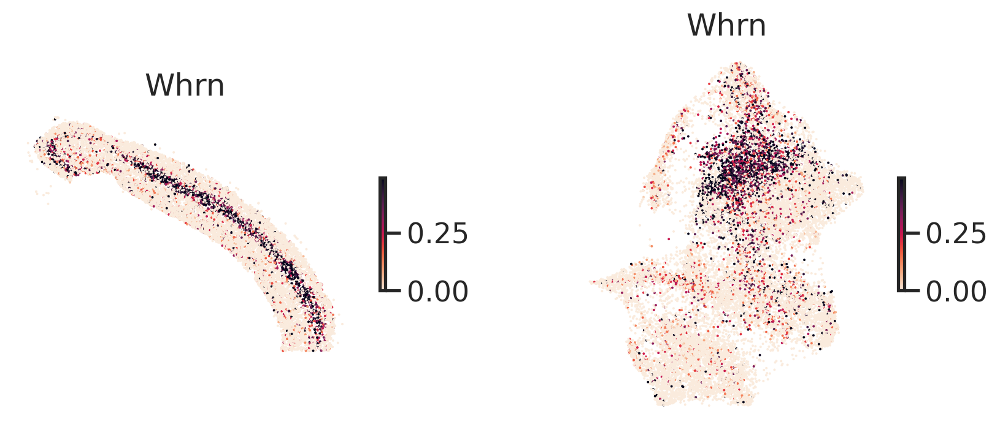

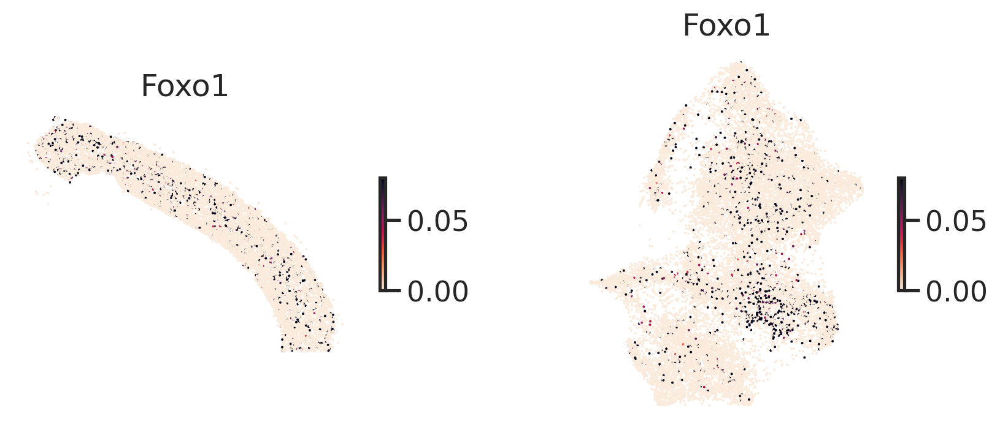

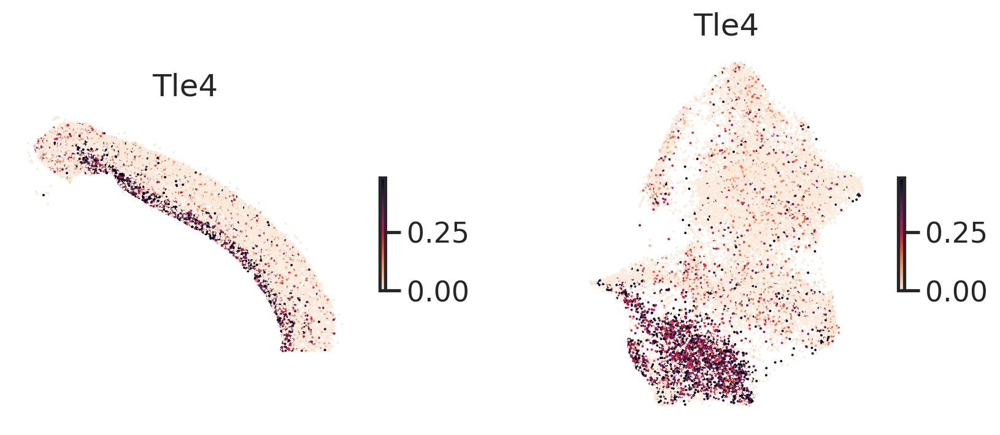

In [16]:
# umap and coordinates
for gn in gns:
    x, y, g = utils_merfish.get_xyg(adata, gn, 'norm')
    ucs = adata.obsm['umap']
    ux = ucs[:,0]
    uy = ucs[:,1]

    fig, axs = plt.subplots(1,2,figsize=(2*5,1*4))
    vmax = np.percentile(g, 95)
    vmin = np.percentile(g,  5)

    ax = axs[0]
    utils_merfish.st_scatter_ax(fig, ax, x, y, gexp=g, s=2, title=gn, vmin=vmin, vmax=vmax, cmap='rocket_r')
    ax = axs[1]
    utils_merfish.st_scatter_ax(fig, ax, ux, uy, gexp=g, s=2, title=gn, vmin=vmin, vmax=vmax, cmap='rocket_r')
    plt.show()

In [19]:
adata.obs


,x,y,gncov,fpcov,EntityID,fov,volume,center_x,center_y,min_x,...,solidity,DAPI_raw,DAPI_high_pass,PolyT_raw,PolyT_high_pass,leiden_r0.1,leiden_r0.2,leiden_spatial_r0.02,leiden_r0.5,leiden
185490,5503.073945,-446.281991,12,0,2596588901979100078,1885,25.181568,446.281991,5503.073945,444.221539,...,2.194123,9611324.0,1.688864e+05,4465327.0,6.059303e+04,0,1,3,4,1
185522,5511.351366,-607.132998,68,0,2596588901980100045,1885,621.816273,607.132998,5511.351366,594.959323,...,1.321448,119659754.0,1.594288e+06,83305078.0,1.078843e+06,0,1,3,4,1
191146,5624.582055,-492.234461,204,1,2596588902031100032,1888,491.929602,492.234461,5624.582055,478.821833,...,0.449421,56879780.0,5.608422e+05,77441525.0,1.164235e+06,0,0,3,2,0
191154,5632.795594,-498.153704,26,0,2596588902031100044,1888,38.946255,498.153704,5632.795594,496.101668,...,1.871594,13431538.0,1.069286e+05,9408821.0,6.688575e+04,0,0,3,1,0
191172,5625.704424,-492.293415,423,2,2596588902031100075,1888,822.633080,492.293415,5625.704424,475.924588,...,0.535864,104961436.0,9.004701e+05,128746047.0,1.358660e+06,0,0,3,2,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
373870,10734.473917,-3704.235356,95,2,2596588904136100156,2475,315.201245,3704.235356,10734.473917,3686.777710,...,0.547051,13521868.0,1.913689e+05,47083986.0,4.117300e+05,0,0,1,2,0
373894,10797.962283,-3862.932954,11,0,2596588904137100026,2474,44.628028,3862.932954,10797.962283,3858.829838,...,0.484072,2138863.0,2.474137e+04,5664845.0,4.346864e+04,0,0,1,2,1
373917,10714.698378,-3823.258623,11,0,2596588904137100065,2475,136.121122,3823.258623,10714.698378,3810.805930,...,0.444151,8199267.0,1.553553e+05,18911552.0,5.660286e+05,0,0,1,1,0
374010,10706.653006,-3932.947219,14,0,2596588904138100061,2474,187.536860,3932.947219,10706.653006,3920.655203,...,0.320200,5566136.0,6.591432e+04,36188828.0,6.265085e+05,0,0,1,4,0


# focus on L2/3/4

In [21]:
adata_sub = adata.copy()
adata_sub = adata_sub[adata_sub.obs['x'] > 7000]
adata_sub = adata_sub[adata_sub.obs['leiden'] == '0']
adata_sub

View of AnnData object with n_obs × n_vars = 9416 × 500
    obs: 'x', 'y', 'gncov', 'fpcov', 'EntityID', 'fov', 'volume', 'center_x', 'center_y', 'min_x', 'min_y', 'max_x', 'max_y', 'anisotropy', 'transcript_count', 'perimeter_area_ratio', 'solidity', 'DAPI_raw', 'DAPI_high_pass', 'PolyT_raw', 'PolyT_high_pass', 'leiden_r0.1', 'leiden_r0.2', 'leiden_spatial_r0.02', 'leiden_r0.5', 'leiden'
    uns: 'leiden', 'neighbors', 'paga', 'leiden_sizes', 'umap', 'leiden_colors'
    obsm: 'blanks', 'pca', 'umap', 'xy', 'X_pca', 'X_umap'
    layers: 'norm', 'lnorm'
    obsp: 'connectivities', 'distances'

In [22]:
adata = adata_sub

In [23]:
lnorm = np.log10(1+adata.layers['norm']) # .sum(axis=1)
pcs = PCA(n_components=20).fit_transform(lnorm)

In [24]:
adata.layers['lnorm'] = lnorm

In [25]:
adata.obsm['X_pca'] = pcs
sc.pp.neighbors(adata, n_neighbors=60, n_pcs=20, use_rep='X_pca')

In [26]:
sc.tl.leiden(adata, resolution=0.2)

In [27]:
sc.tl.paga(adata)
sc.pl.paga(adata, plot=False)  # remove `plot=False` if you want to see the coarse-grained graph
sc.tl.umap(adata, init_pos='paga')

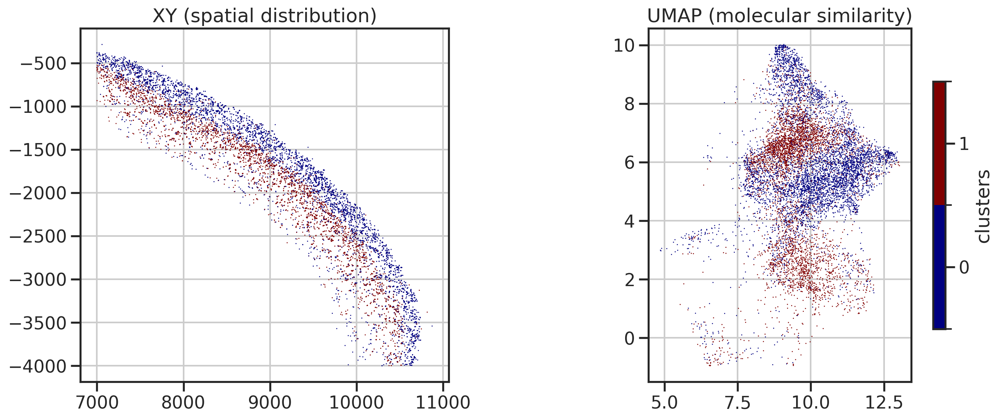

In [28]:
clsts = adata.obs['leiden'].astype(int)
x = adata.obs['x']
y = adata.obs['y']
ux = adata.obsm['umap'][:,0]
uy = adata.obsm['umap'][:,1]
plot_cluster(clsts, x, y, ux, uy, axis_off=False)
plt.show()

/u/home/f/f7xiesnm/.conda/envs/napari/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


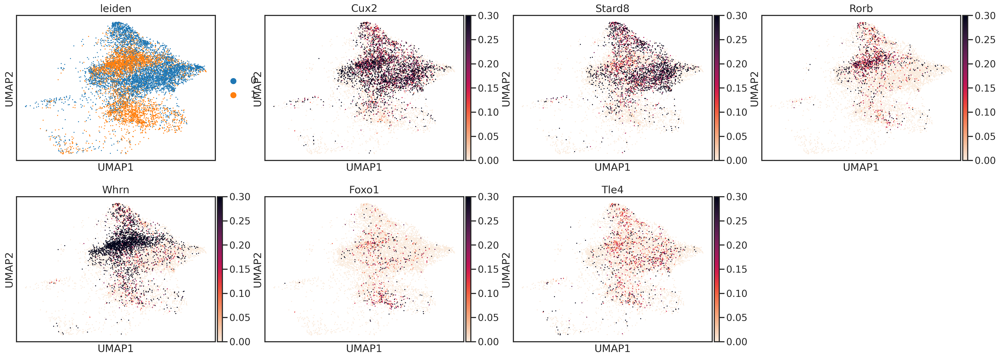

In [29]:
gns = ['Cux2', 'Stard8', 'Rorb', 'Whrn', 'Foxo1', 'Tle4']
sc.pl.umap(adata, layer='lnorm', color=['leiden']+gns, cmap='rocket_r', vmax=0.3)

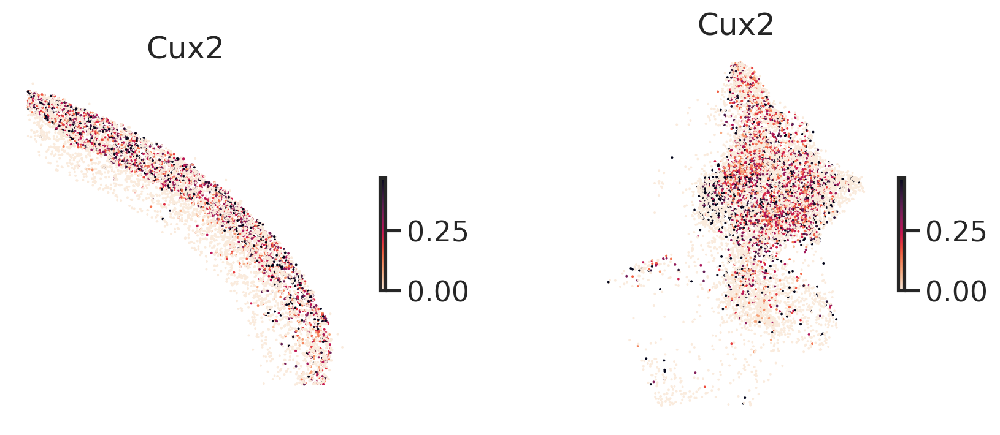

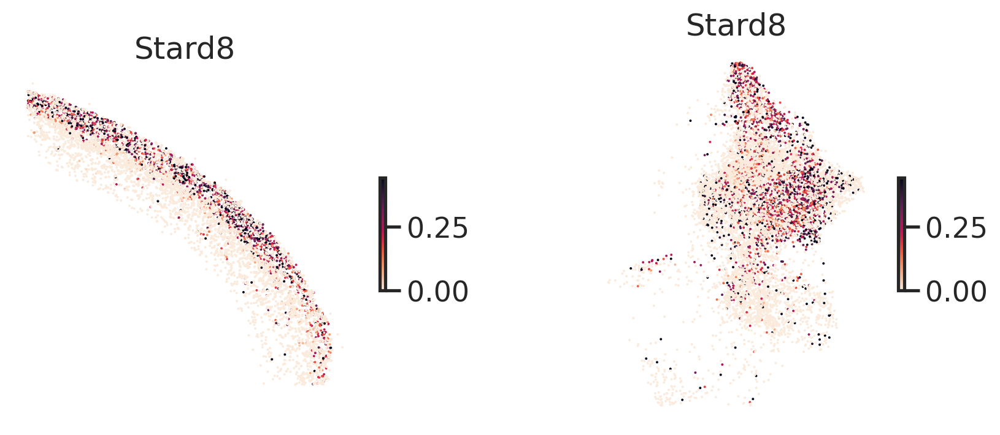

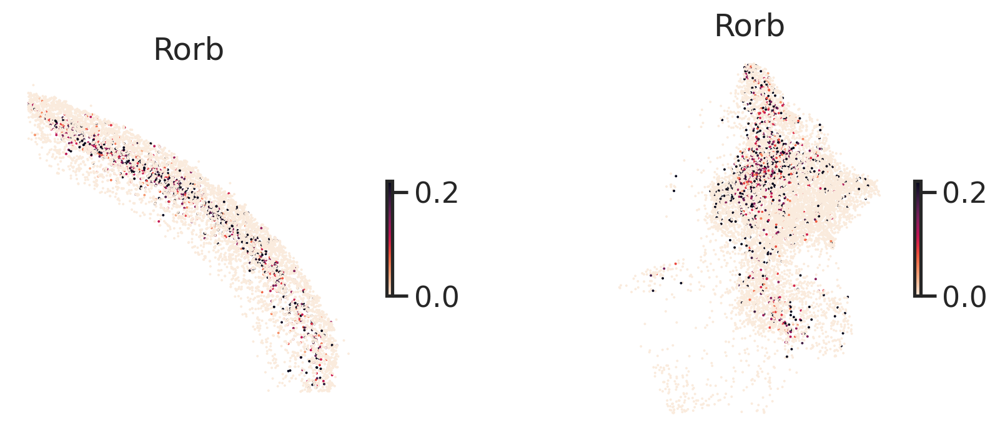

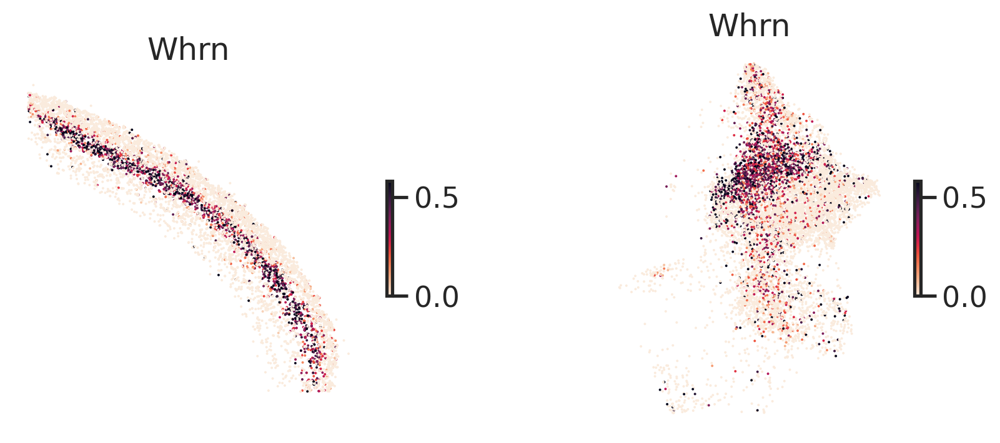

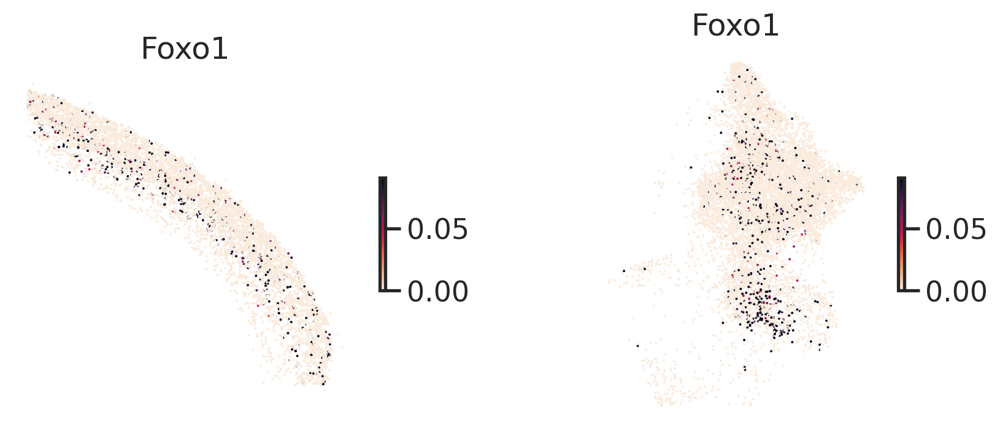

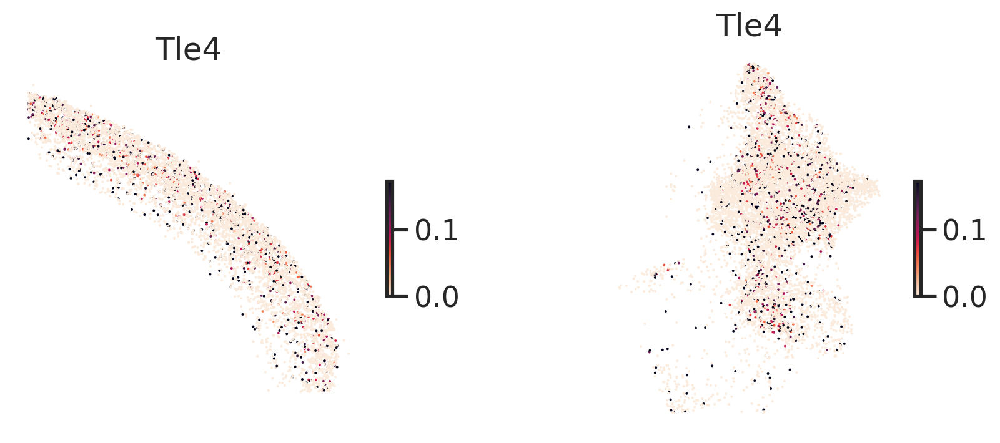

In [30]:
# umap and coordinates
for gn in gns:
    x, y, g = utils_merfish.get_xyg(adata, gn, 'norm')
    ucs = adata.obsm['umap']
    ux = ucs[:,0]
    uy = ucs[:,1]

    fig, axs = plt.subplots(1,2,figsize=(2*5,1*4))
    vmax = np.percentile(g, 95)
    vmin = np.percentile(g,  5)

    ax = axs[0]
    utils_merfish.st_scatter_ax(fig, ax, x, y, gexp=g, s=2, title=gn, vmin=vmin, vmax=vmax, cmap='rocket_r')
    ax = axs[1]
    utils_merfish.st_scatter_ax(fig, ax, ux, uy, gexp=g, s=2, title=gn, vmin=vmin, vmax=vmax, cmap='rocket_r')
    plt.show()

# focus on L2/3

In [31]:
adata_sub = adata.copy()
adata_sub = adata_sub[adata_sub.obs['leiden'] == '0']
adata_sub

View of AnnData object with n_obs × n_vars = 5379 × 500
    obs: 'x', 'y', 'gncov', 'fpcov', 'EntityID', 'fov', 'volume', 'center_x', 'center_y', 'min_x', 'min_y', 'max_x', 'max_y', 'anisotropy', 'transcript_count', 'perimeter_area_ratio', 'solidity', 'DAPI_raw', 'DAPI_high_pass', 'PolyT_raw', 'PolyT_high_pass', 'leiden_r0.1', 'leiden_r0.2', 'leiden_spatial_r0.02', 'leiden_r0.5', 'leiden'
    uns: 'leiden', 'neighbors', 'paga', 'leiden_sizes', 'umap', 'leiden_colors'
    obsm: 'blanks', 'pca', 'umap', 'xy', 'X_pca', 'X_umap'
    layers: 'norm', 'lnorm'
    obsp: 'connectivities', 'distances'

In [32]:
adata = adata_sub

In [33]:
lnorm = np.log10(1+adata.layers['norm']) # .sum(axis=1)
pcs = PCA(n_components=20).fit_transform(lnorm)

In [34]:
adata.layers['lnorm'] = lnorm

In [35]:
adata.obsm['X_pca'] = pcs
sc.pp.neighbors(adata, n_neighbors=60, n_pcs=20, use_rep='X_pca')

In [38]:
sc.tl.leiden(adata, resolution=1)

In [39]:
sc.tl.paga(adata)
sc.pl.paga(adata, plot=False)  # remove `plot=False` if you want to see the coarse-grained graph
sc.tl.umap(adata, init_pos='paga')

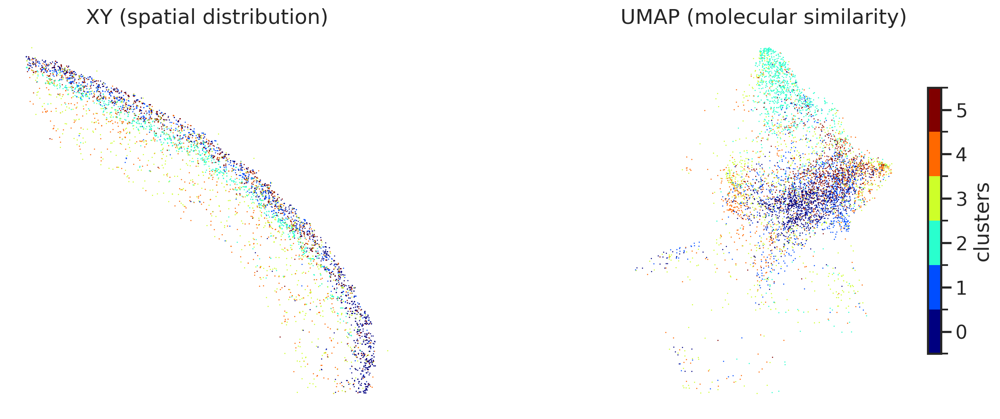

In [44]:
clsts = adata.obs['leiden'].astype(int)
x = adata.obs['x']
y = adata.obs['y']
ux = adata.obsm['umap'][:,0]
uy = adata.obsm['umap'][:,1]
plot_cluster(clsts, x, y, ux, uy, axis_off=True)
plt.show()

# remove noise

In [46]:
adataplot = adata[adata.obs['leiden'].isin(['0', '1', '2'])]

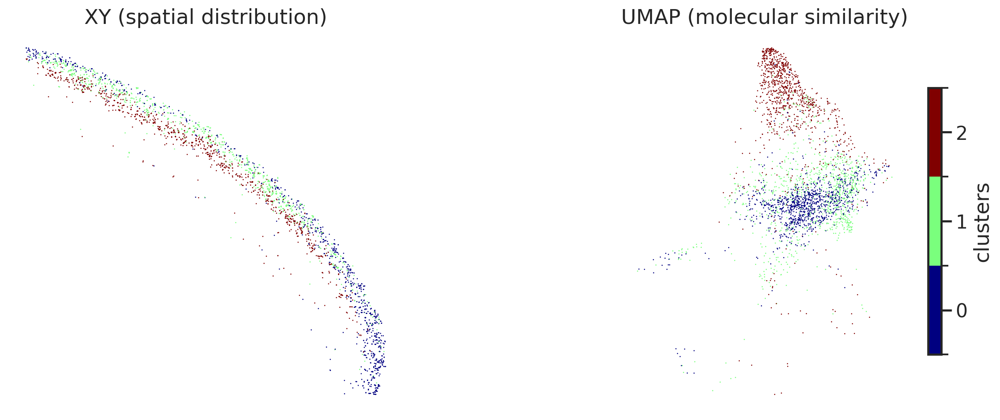

In [47]:
clsts = adata_plot.obs['leiden'].astype(int)
x = adata_plot.obs['x']
y = adata_plot.obs['y']
ux = adata_plot.obsm['umap'][:,0]
uy = adata_plot.obsm['umap'][:,1]
plot_cluster(clsts, x, y, ux, uy, axis_off=True)
plt.show()

/u/home/f/f7xiesnm/.conda/envs/napari/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


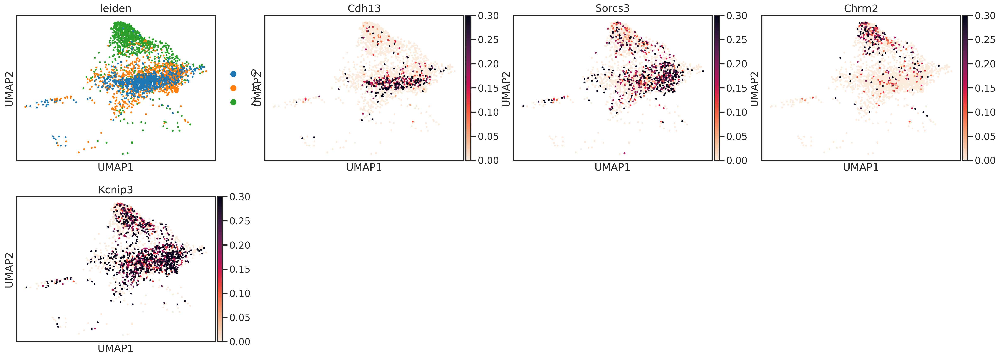

In [53]:
gns = ['Cdh13', 'Sorcs3', 'Chrm2', 'Kcnip3']
sc.pl.umap(adata_plot, layer='lnorm', color=['leiden']+gns, cmap='rocket_r', vmax=0.3)

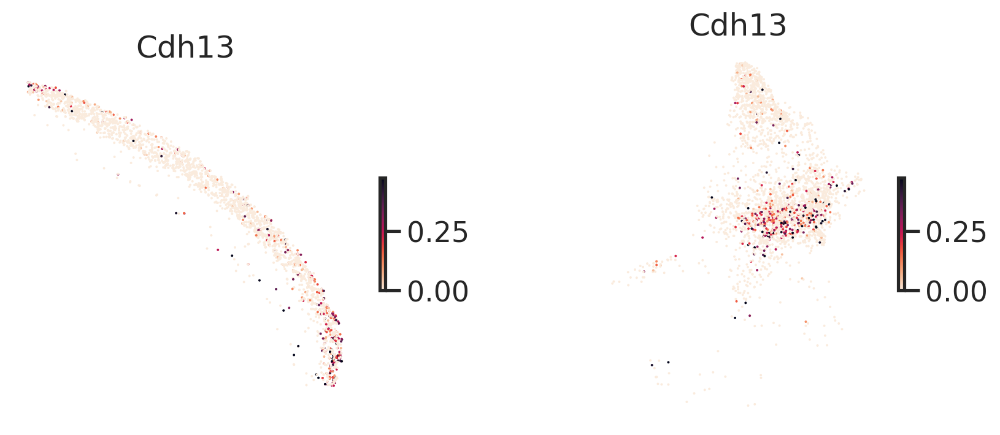

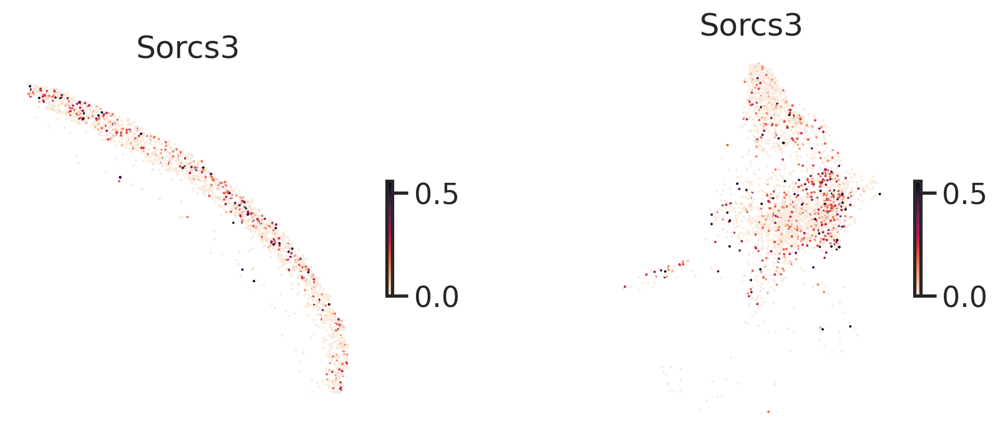

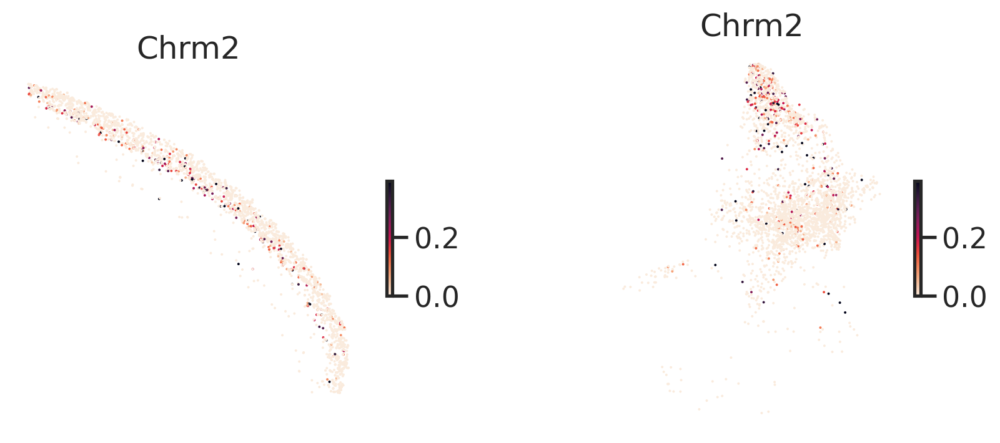

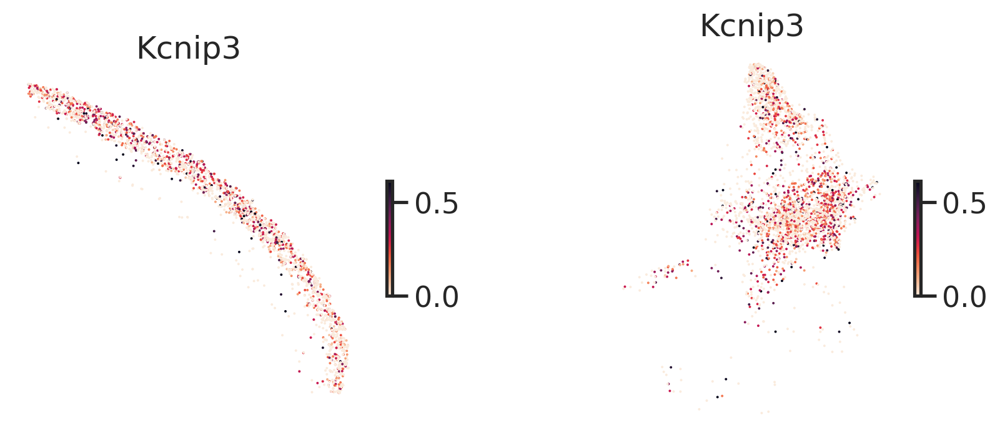

In [55]:
# umap and coordinates
for gn in gns:
    x, y, g = utils_merfish.get_xyg(adata_plot, gn, 'norm')
    ucs = adata_plot.obsm['umap']
    ux = ucs[:,0]
    uy = ucs[:,1]

    fig, axs = plt.subplots(1,2,figsize=(2*5,1*4))
    vmax = np.percentile(g, 99)
    vmin = np.percentile(g,  5)

    ax = axs[0]
    utils_merfish.st_scatter_ax(fig, ax, x, y, gexp=g, s=2, title=gn, vmin=vmin, vmax=vmax, cmap='rocket_r')
    ax = axs[1]
    utils_merfish.st_scatter_ax(fig, ax, ux, uy, gexp=g, s=2, title=gn, vmin=vmin, vmax=vmax, cmap='rocket_r')
    plt.show()